In [449]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy.io import wavfile
from IPython.display import Audio
from scipy import fft
import librosa
import librosa.display
from wavinfo import WavInfoReader
import pandas as pd

In [450]:
df_drummers = pd.read_csv('../raw_data/groove/info.csv')
df_drummers.head()

,drummer,session,id,style,bpm,beat_type,time_signature,midi_filename,audio_filename,duration,split
0,drummer1,drummer1/eval_session,drummer1/eval_session/1,funk/groove1,138,beat,4-4,drummer1/eval_session/1_funk-groove1_138_beat_...,drummer1/eval_session/1_funk-groove1_138_beat_...,27.872308,test
1,drummer1,drummer1/eval_session,drummer1/eval_session/10,soul/groove10,102,beat,4-4,drummer1/eval_session/10_soul-groove10_102_bea...,drummer1/eval_session/10_soul-groove10_102_bea...,37.691158,test
2,drummer1,drummer1/eval_session,drummer1/eval_session/2,funk/groove2,105,beat,4-4,drummer1/eval_session/2_funk-groove2_105_beat_...,drummer1/eval_session/2_funk-groove2_105_beat_...,36.351218,test
3,drummer1,drummer1/eval_session,drummer1/eval_session/3,soul/groove3,86,beat,4-4,drummer1/eval_session/3_soul-groove3_86_beat_4...,drummer1/eval_session/3_soul-groove3_86_beat_4...,44.716543,test
4,drummer1,drummer1/eval_session,drummer1/eval_session/4,soul/groove4,80,beat,4-4,drummer1/eval_session/4_soul-groove4_80_beat_4...,drummer1/eval_session/4_soul-groove4_80_beat_4...,47.987500,test


# Basic exploration and preprocessing

## Dropping purposeless columns and duplicates

In [451]:
df_drummers = df_drummers.drop(columns=['session', 'split', 'midi_filename'])
#df_drummers = df_drummers[df_drummers.beat_type == 'beat']

In [452]:
df_drummers.isnull().sum().sort_values(ascending=False)/len(df_drummers)

audio_filename    0.052174
drummer           0.000000
id                0.000000
style             0.000000
bpm               0.000000
beat_type         0.000000
time_signature    0.000000
duration          0.000000
dtype: float64

In [453]:
len(df_drummers)

1150

In [454]:
df_drummers.dropna(subset=['audio_filename'], inplace=True)

In [455]:
len(df_drummers)

1090

## First exploration of styles

Let's have a look at all different styles

In [456]:
list_of_styles = df_drummers['style'].unique()
print(list_of_styles)
print(len(list_of_styles))

['funk/groove1' 'soul/groove10' 'funk/groove2' 'soul/groove3'
 'soul/groove4' 'funk/groove5' 'hiphop/groove6' 'pop/groove7'
 'rock/groove8' 'soul/groove9' 'funk' 'jazz/funk' 'neworleans/secondline'
 'dance/disco' 'funk/fast' 'latin/brazilian-baiao' 'afrocuban' 'reggae'
 'reggae/slow' 'rock/halftime' 'funk/purdieshuffle' 'latin/samba' 'jazz'
 'rock/shuffle' 'jazz/mediumfast' 'jazz/fast' 'latin/reggaeton'
 'dance/breakbeat' 'neworleans/funk' 'latin/chacarera' 'country'
 'funk/rock' 'rock/prog' 'afrocuban/bembe' 'gospel' 'afrocuban/rhumba'
 'rock' 'punk' 'jazz/march' 'rock/folk' 'afrobeat' 'latin/bomba'
 'afrocuban/calypso' 'jazz/swing' 'rock/rockabilly' 'jazz/linear' 'hiphop'
 'jazz/klezmer' 'latin/brazilian' 'blues/shuffle' 'latin/merengue'
 'latin/brazilian-bossa' 'latin/brazilian-sambareggae'
 'latin/brazilian-songo' 'middleeastern' 'latin/brazilian-samba'
 'latin/brazilian-maracatu' 'latin/venezuelan-merengue'
 'latin/dominican-merengue' 'latin/venezuelan-sangueo' 'soul'
 'latin/vene

In [457]:
styles_count = pd.DataFrame(df_drummers['style'].value_counts())
styles_count

,style
rock,258
hiphop,89
funk,69
punk,58
neworleans/funk,46
...,...
middleeastern,1
reggae/slow,1
rock/rockabilly,1
latin/merengue,1


In [458]:
funky = df_drummers[df_drummers['style'].str.contains("funk")==True]
funky['style'].unique()

array(['funk/groove1', 'funk/groove2', 'funk/groove5', 'funk',
       'jazz/funk', 'funk/fast', 'funk/purdieshuffle', 'neworleans/funk',
       'funk/rock', 'funk/latin'], dtype=object)

In [459]:
def transform_genres(DataFrame):
    list_of_genres = ['afrobeat',
                  'afrocuban',
                  'blues',
                  'country',
                  'dance',
                  'funk',
                  'gospel',
                  'highlife',
                  'hiphop',
                  'jazz',
                  'latin',
                  'middleeastern',
                  'neworleans',
                  'pop',
                  'punk',
                  'reggae',
                  'rock',
                  'soul']

    for genre in list_of_genres:
        df_drummers.loc[df_drummers['style'].str.contains(genre), 'style'] = genre

    return df_drummers

df_drummers = transform_genres(df_drummers)

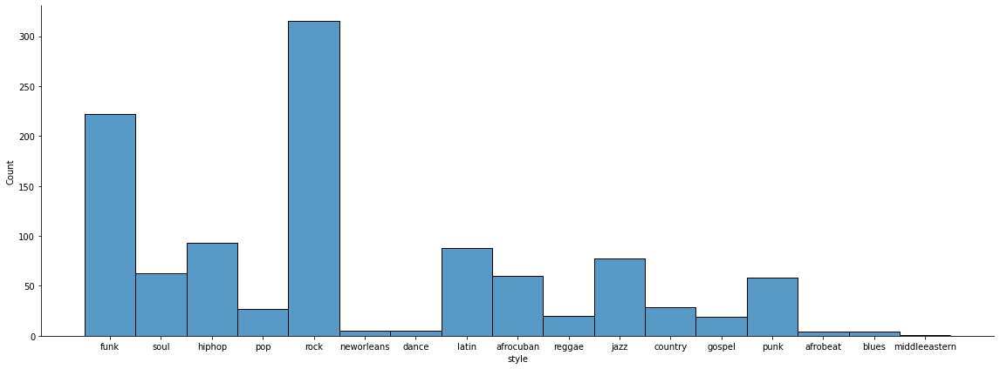

In [460]:
sns.displot(df_drummers['style'], height=6,aspect=2.67)

## Separating beats and fills

In [461]:
df_beats = df_drummers[df_drummers['beat_type'] == 'beat']
df_fills = df_drummers[df_drummers['beat_type'] == 'fill']

In [462]:
np.arange(0.1, 0.9, 0.1)

array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8])

# Exploring lengths

In [463]:
print(df_drummers['duration'].describe(np.arange(0.1, 0.9, 0.1)))
print()
print(df_beats['duration'].describe(np.arange(0.1, 0.9, 0.1)))
print()
print(df_fills['duration'].describe(np.arange(0.1, 0.9, 0.1)))


count    1090.000000
mean       35.534095
std        67.074063
min         0.679898
10%         1.725747
20%         1.895679
30%         2.085580
40%         2.501104
50%         3.464202
60%         5.373132
70%        22.168908
80%        50.711241
max       611.564048
Name: duration, dtype: float64

count    444.000000
mean      83.266764
std       84.857460
min        1.290000
10%        6.063854
20%       12.696894
30%       27.272930
40%       36.769113
50%       48.396946
60%       78.956094
70%      114.114884
80%      146.436750
max      611.564048
Name: duration, dtype: float64

count    646.000000
mean       2.727121
std        1.962488
min        0.679898
10%        1.614585
20%        1.778000
30%        1.869554
40%        1.965911
50%        2.142526
60%        2.422365
70%        2.639641
80%        3.421640
max       37.661667
Name: duration, dtype: float64


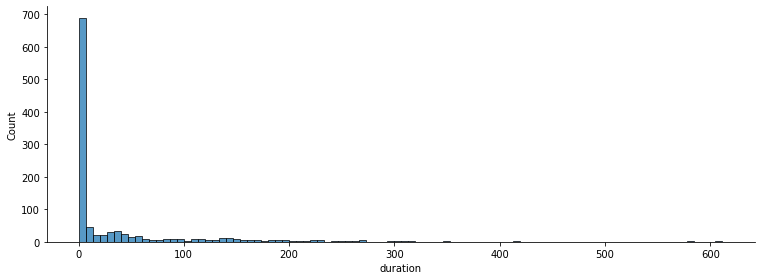

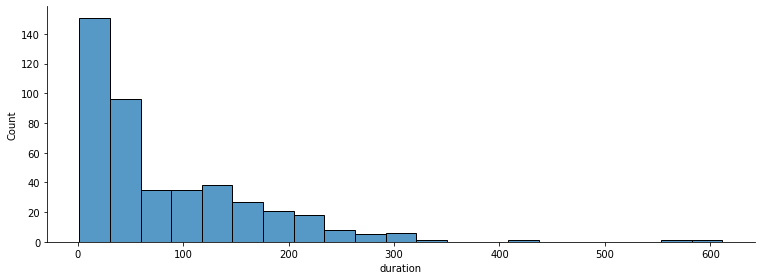

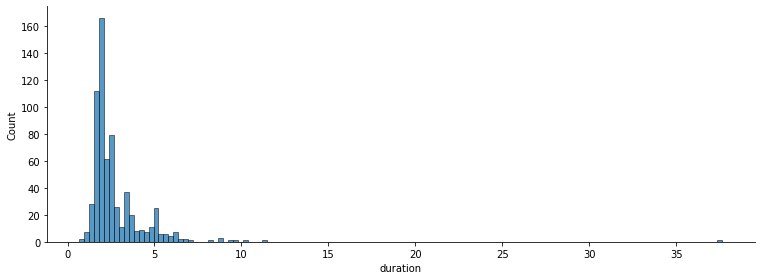

In [464]:
sns.displot(df_drummers['duration'], height=4,aspect=2.67)
sns.displot(df_beats['duration'], height=4,aspect=2.67)
sns.displot(df_fills['duration'], height=4,aspect=2.67)

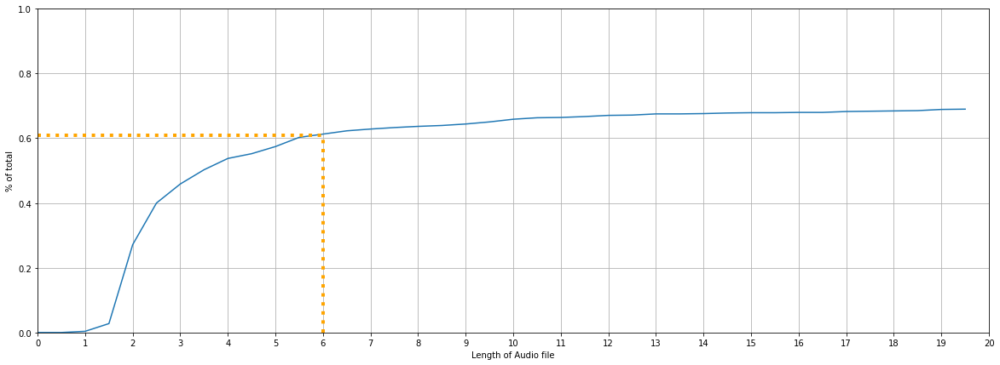

In [465]:
lengths = np.arange(0, 20, 0.5)
ratio = []
for duration in lengths:
    ratio.append(len(df_drummers[df_drummers['duration'] < duration])/len(df_drummers))

fig = plt.figure(figsize=(20,7))
plt.plot(lengths, ratio)
plt.xlabel('Length of Audio file')
plt.ylabel('% of total')
plt.xticks(np.arange(0, 50, 1))

plt.grid()
plt.xlim((0, 20))
plt.ylim((0, 1))


plt.hlines(y=0.61, xmin=0, xmax=6,
           linestyles='dotted', colors=['orange'], linewidth=4)
plt.vlines(x=6, ymin=0, ymax=.61,
           linestyles='dotted', colors=['orange'], linewidth=4);

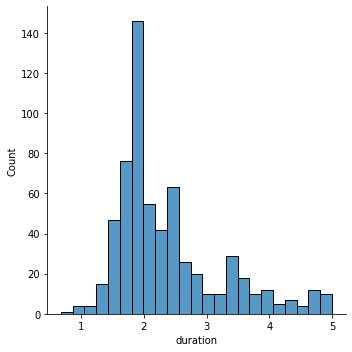

In [466]:
sns.displot(df_drummers[df_drummers['duration'] < 5]['duration'])

<b> Conclusion: </b>
A length of 6 secs should be long enough to capture essential information about the drum beats, and short enough not to add too much padding to very short samples. 

# Building a dummy baseline model

In [467]:
X = df_drummers.loc[:, df_drummers.columns != 'style']
y = df_drummers['style']

In [468]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size = 0.3, random_state = 0)

In [469]:
from sklearn.dummy import DummyClassifier

strategies = ['most_frequent', 'stratified', 'uniform']
  
test_scores = []
for s in strategies:
    dclf = DummyClassifier(strategy = s, random_state = 0)
    dclf.fit(X_train, y_train)
    score = dclf.score(X_test, y_test)
    test_scores.append(score)

/Users/raphaelcommere/.pyenv/versions/3.8.12/envs/lewagon/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


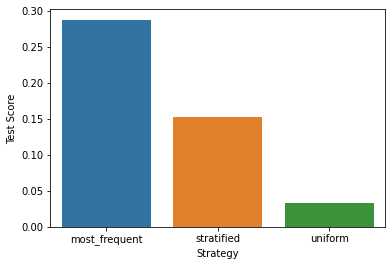

In [470]:
ax = sns.barplot(strategies, test_scores);
ax.set(xlabel ='Strategy', ylabel ='Test Score')
plt.show()

# (Optional) Sub-Genres fine exploration

Let's explore the following genres to see if we can delete some subgenres:
- Funky
- Rock / Pop / Punk
- Latin
- Jazz
- Dance
- Other (country, middle eastern...)

## Funk and Groove

In [333]:
funky = df_drummers[df_drummers['style'].str.contains("funk")==True]
funky.reset_index()

,index,drummer,id,style,bpm,beat_type,time_signature,audio_filename,duration
0,0,drummer1,drummer1/eval_session/1,funk,138,beat,4-4,drummer1/eval_session/1_funk-groove1_138_beat_...,27.872308
1,2,drummer1,drummer1/eval_session/2,funk,105,beat,4-4,drummer1/eval_session/2_funk-groove2_105_beat_...,36.351218
2,5,drummer1,drummer1/eval_session/5,funk,84,beat,4-4,drummer1/eval_session/5_funk-groove5_84_beat_4...,45.687518
3,10,drummer1,drummer1/session1/1,funk,80,beat,4-4,drummer1/session1/1_funk_80_beat_4-4.wav,86.704688
4,11,drummer1,drummer1/session1/10,funk,116,fill,4-4,drummer1/session1/10_jazz-funk_116_fill_4-4.wav,1.872843
...,...,...,...,...,...,...,...,...,...
217,1051,drummer8,drummer8/session1/25,funk,100,beat,4-4,drummer8/session1/25_funk-latin_100_beat_4-4.wav,124.891250
218,1058,drummer8,drummer8/session1/6,funk,80,beat,4-4,drummer8/session1/6_funk_80_beat_4-4.wav,167.734375
219,1059,drummer8,drummer8/session1/7,funk,80,beat,4-4,drummer8/session1/7_funk_80_beat_4-4.wav,155.762500
220,1060,drummer8,drummer8/session1/8,funk,96,beat,4-4,drummer8/session1/8_funk_96_beat_4-4.wav,159.484375


In [334]:
pd.DataFrame(funky['style'].value_counts())

,style
funk,222


In [335]:
funky[funky['style']=='neworleans/funk']

,drummer,id,style,bpm,beat_type,time_signature,audio_filename,duration


In [129]:
funkybeat = funky[funky['style']=='neworleans/funk'].loc[259, 'audio_filename']
wavFile = '../raw_data/groove/' + funkybeat
Audio(wavFile)